<h2><center>Alessandro Josué da Silva<i><br>ajsilva@ucs.br</i><br><br>Caio Gustavo Rodrigues da Silva <br><i>cgrsilva@ucs.br</i></center></h2>

<br><h1><center><b>PRÉ-PROCESSAMENTO, ANÁLISE EXPLORATÓRIA E APLICAÇÃO DE CLUSTERIZAÇÃO NOS DADOS DO ENEM 2019 COM O USO DO K-MEANS</b></center></h1><br>

# 1. INTRODUÇÃO<br>

<div align="justify"><i>Inteligência artificial</i> é um campo da tecnologia dedicado à simulação de inteligência, à semelhança da inteligência humana, em máquinas. Além de prover respostas com base em perguntas por meio de programação, a IA vai além, permitindo a sistemas computacionais "descobrirem" respostas a perguntas ainda não feitas, através de aprendizado [1].</div><br>

<div align="justify">A IA é uma área vasta de conhecimento, dividida em sub áreas, como aprendizado de máquina (do inglês <i>Machine Learning</i>), aprendizado profundo (ou <i>Deep Learning</i>) e processamento de linguagem natural - <i>PLN</i>. Nas últimas décadas muito do foco colocado nesse campo de estudo têm sido concentrado especificamente no estudo de Machine Learning (ML) [2].</div><br>

<div align="justify">Os estudos relacionados a ML se difundiram, principalmente, devido às pesquisas relacionadas ao reconhecimento de padrões e da importância da automação destes processos, através da concepção de máquinas computadorizadas que detivessem a capacidade de aprender novas atividades, sem a necessidade de serem pré-programadas, com base em dados retroativos [3].</div><br>

<div align="justify">Desta maneira, a técnica de ML pode ser caracterizada como a habilidade de proporcionar conhecimento a computadores utilizando-se de dados de eventos passados. Por meio desta técnica é possível realizar a identificação de padrões e características que dificilmente seriam perceptíveis de maneira clara para um humano [4].</div><br>

<div align="justify">Os estudos relacionados ao Aprendizado de Máquinas podem ser subdivididos em três conjuntos: algoritmos de aprendizado supervisionado, não-supervisionado e semisupervisionado.</div><br>

## 1.1. Algoritmos supervisionados<br>

<div align="justify">De acordo com Shalev-Shwartz e Ben-David [5], os algoritmos pertencentes ao conjunto dos supervisionados utilizam-se da experiência para a obtenção de conhecimento. Nestes algoritmos são utilizados dados pré-rotulados na etapa de treinamento, para posterior reconhecimento e classificação de novos dados. Estes podem ser divididos entre os de classificação, onde o algoritmo classifica a informação em categorias, ou regressão, que resulta em valores contínuos.</div><br>

## 1.2. Algoritmos não supervisionados<br>

<div align="justify">Os algoritmos não supervisionados são utilizados quando não se possui rótulos prévios para a classificação dos dados [4]. Estes algoritmos possuem dados de entrada e nenhuma resposta como saída e sua utilização resulta em grupos (clusters) de dados com características em comum [6], que geralmente necessitam de uma análise para a extração de conhecimento de cada agrupamento [7].</div><br>

### 1.2.1. K-Means<br>

<div align="justify">O K-Means pertence ao grupo dos algoritmos de aprendizado de máquina não supervisionados, pois não trabalha com dados rotulados. Este algoritmo tem como objetivo a realização de agrupamento de dados de acordo com as suas similaridades, ou seja, realizar o agrupamento através das semelhanças encontradas em cada atributo da fonte de dados [8].  O método K-Means, utiliza-se da distância euclidiana entre os itens para a realização dos agrupamentos [9], onde dado um número de clusters, previamente determinado, é realizado o cálculo da distância euclidiana entre os pontos e os centróides. Segundo Santana [8], esta iteração entre os dados ocorre N vezes e a cada nova iteração é calculada a média dos valores dos pontos de cada cluster e o valor médio será o novo centroide.</div><br>

## 1.3. Algoritmos semissupervisionados<br>

<div align="justify">Segundo Filho [10], os algoritmos do conjunto de semi-supervisionados são uma abordagem intermediária entre os algoritmos de aprendizagem supervisionada e não supervisionada. Estes se caracterizam, principalmente, pela possibilidade de suportarem as tarefas de classificação de dados e as tarefas de agrupamento.</div><br>

# 2. MATERIAIS E MÉTODOS<br>

<div align="justify">O desenvolvimento deste projeto tem como principal objetivo a exploração e análise de dados retroativos do ENEM (Exame Nacional do Ensino Médio), no Brasil, do ano de 2019. O ENEM, criado no ano de 1998, tem como objetivos: avaliar o desempenho dos estudantes do ensino médio, ser uma nota de corte para o egresso dos participantes em instituições do ensino superior e ser um critério de seleção para os estudantes que pretendem concorrer a programas de ensino, como o ProUni, fornecidos pelo governo [11].</div><br>

## 2.1. Dados do ENEM<br>

<div align="justify">Os dados foram obtidos a partir do site do <a href="http://download.inep.gov.br/microdados/microdados_enem_2019.zip" target="_blank">INEP</a>, e a descrição de cada <i>feature</i> pode ser consultada em <a href="https://github.com/alura-cursos/imersao-dados-2-2020/tree/master/DICION%C3%81RIO" target="_blank">Dicionário ENEM 2019 Alura</a>.</div><br>

<div align="justify">Esse estudo se baseou na relação entre os dados do questionário socioeconômico e a nota média da prova, que considera as diferentes áreas avaliadas pelo ENEM mais a nota da redação, para responder a seguinte pergunta: <b>A nota média pode ser influenciada pelas condições socioeconômicas dos participantes?</b></div><br>

<div align="justify">A hipótese é de que sim, a condição social pode influenciar na nota do ENEM.</div>

## 2.2. EDA I: *Exploratory Data Analysis* - *dataset* original<br>

### 2.2.1. Importação dos pacotes<br>

<div align="justify">Os pacotes utilizados trabalham desde o carregamento do arquivo para um <i>dataframe</i>, como <b>Pandas</b> e <b>Dask Dataframe</b> até visualização, como <b>Seaborn</b>, <b>Matplolib</b> e <b>Plotly</b>, passando pelos algoritmos de aprendizado de máquina, como <b>K-Means</b> (um <i>sub package</i> do Scikit Learn), e ferramentas adicionais de análise, como <b>Kneed</b> e <b>Yellowbrick</b>. </div><br>

In [1]:
import pandas as pd
import matplotlib.pyplot as plt  
import numpy as np
import seaborn as sns
import scipy.cluster.hierarchy as shc
import time

from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.cluster import KMeans
from yellowbrick.cluster.elbow import kelbow_visualizer
from kneed import KneeLocator
from sklearn.manifold import TSNE
from sklearn.preprocessing import OrdinalEncoder

import plotly.express as px
import plotly.graph_objects as go
import plotly.offline as py

%matplotlib inline
sns.set(style = "darkgrid")
ini = time.time()

### 2.2.2. Carregamento dos dados para um *dataframe*<br>


In [2]:
fonte = "https://github.com/alura-cursos/imersao-dados-2-2020/blob/master/MICRODADOS_ENEM_2019_SAMPLE_43278.csv?raw=true"

df = pd.read_csv(fonte)

df.head()

,NU_INSCRICAO,NU_ANO,CO_MUNICIPIO_RESIDENCIA,NO_MUNICIPIO_RESIDENCIA,CO_UF_RESIDENCIA,SG_UF_RESIDENCIA,NU_IDADE,TP_SEXO,TP_ESTADO_CIVIL,TP_COR_RACA,...,Q016,Q017,Q018,Q019,Q020,Q021,Q022,Q023,Q024,Q025
0,190001004661,2019,1506138,Redenção,15,PA,17,M,1,3,...,A,A,A,A,B,A,C,A,B,B
1,190001004674,2019,1504208,Marabá,15,PA,23,M,1,3,...,A,A,A,B,A,A,B,A,A,B
2,190001004722,2019,1501402,Belém,15,PA,35,F,2,1,...,A,A,A,B,A,B,B,A,A,B
3,190001004735,2019,1507300,São Félix do Xingu,15,PA,23,F,1,3,...,A,A,A,B,A,A,B,A,A,B
4,190001004776,2019,1500800,Ananindeua,15,PA,16,F,1,3,...,A,A,A,B,A,A,D,A,A,B


In [3]:
# Conhecendo a estrutura do dataset
df.shape

(127380, 136)

In [4]:
# Conhecendo as colunas existentes
df.columns.values

array(['NU_INSCRICAO', 'NU_ANO', 'CO_MUNICIPIO_RESIDENCIA',
       'NO_MUNICIPIO_RESIDENCIA', 'CO_UF_RESIDENCIA', 'SG_UF_RESIDENCIA',
       'NU_IDADE', 'TP_SEXO', 'TP_ESTADO_CIVIL', 'TP_COR_RACA',
       'TP_NACIONALIDADE', 'CO_MUNICIPIO_NASCIMENTO',
       'NO_MUNICIPIO_NASCIMENTO', 'CO_UF_NASCIMENTO', 'SG_UF_NASCIMENTO',
       'TP_ST_CONCLUSAO', 'TP_ANO_CONCLUIU', 'TP_ESCOLA', 'TP_ENSINO',
       'IN_TREINEIRO', 'CO_ESCOLA', 'CO_MUNICIPIO_ESC',
       'NO_MUNICIPIO_ESC', 'CO_UF_ESC', 'SG_UF_ESC',
       'TP_DEPENDENCIA_ADM_ESC', 'TP_LOCALIZACAO_ESC', 'TP_SIT_FUNC_ESC',
       'IN_BAIXA_VISAO', 'IN_CEGUEIRA', 'IN_SURDEZ',
       'IN_DEFICIENCIA_AUDITIVA', 'IN_SURDO_CEGUEIRA',
       'IN_DEFICIENCIA_FISICA', 'IN_DEFICIENCIA_MENTAL',
       'IN_DEFICIT_ATENCAO', 'IN_DISLEXIA', 'IN_DISCALCULIA',
       'IN_AUTISMO', 'IN_VISAO_MONOCULAR', 'IN_OUTRA_DEF', 'IN_GESTANTE',
       'IN_LACTANTE', 'IN_IDOSO', 'IN_ESTUDA_CLASSE_HOSPITALAR',
       'IN_SEM_RECURSO', 'IN_BRAILLE', 'IN_AMPLIADA_24

In [5]:
# Pré-análise das provas do enem
df.rename(columns = {
    'NU_NOTA_CN':'NOTAS_CIENCIAS_NATUREZA', 
    'NU_NOTA_CH': 'NOTA_HUMANAS', 
    'NU_NOTA_MT': 'NOTA_MATEMATICA', 
    'NU_NOTA_LC': 'NOTA_LINGUAS', 
    'NU_NOTA_REDACAO': 'NOTA_REDACAO'
}, inplace = True) 

tests = [
    "NOTAS_CIENCIAS_NATUREZA",
    "NOTA_HUMANAS",
    "NOTA_MATEMATICA",
    "NOTA_LINGUAS",
    "NOTA_REDACAO"
]

df[tests].describe()

,NOTAS_CIENCIAS_NATUREZA,NOTA_HUMANAS,NOTA_MATEMATICA,NOTA_LINGUAS,NOTA_REDACAO
count,92758.000000,98043.000000,92758.000000,98043.000000,98043.000000
mean,477.964015,507.365912,523.555206,520.463928,571.570025
std,76.296099,82.972839,109.416939,64.556578,188.076455
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,418.000000,447.900000,435.300000,483.700000,480.000000
50%,470.200000,510.900000,501.600000,526.100000,580.000000
75%,533.300000,567.100000,598.200000,565.100000,680.000000
max,797.300000,809.400000,985.000000,801.700000,1000.000000


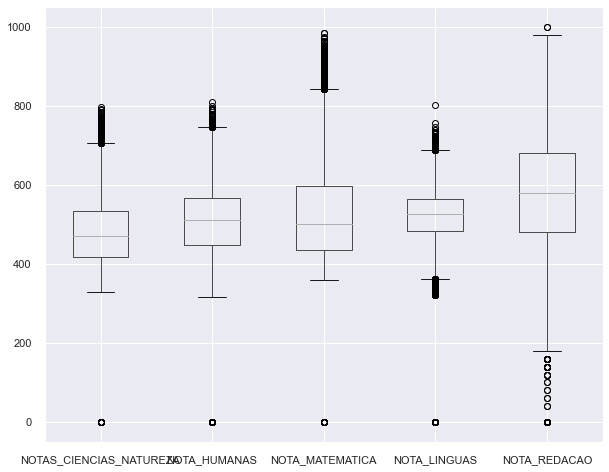

In [6]:
df[tests].boxplot(
    grid=True, 
    figsize= (10,8)
)
plt.savefig('./ImgOut/boxplot_notas_provas.png')

### 2.2.3. Pré-Processamento de Dados<br>


In [7]:
# Colunas com dados null
df.columns[df.isnull().any()]

Index(['CO_MUNICIPIO_NASCIMENTO', 'NO_MUNICIPIO_NASCIMENTO',
       'CO_UF_NASCIMENTO', 'SG_UF_NASCIMENTO', 'TP_ENSINO', 'CO_ESCOLA',
       'CO_MUNICIPIO_ESC', 'NO_MUNICIPIO_ESC', 'CO_UF_ESC', 'SG_UF_ESC',
       'TP_DEPENDENCIA_ADM_ESC', 'TP_LOCALIZACAO_ESC', 'TP_SIT_FUNC_ESC',
       'CO_PROVA_CN', 'CO_PROVA_CH', 'CO_PROVA_LC', 'CO_PROVA_MT',
       'NOTAS_CIENCIAS_NATUREZA', 'NOTA_HUMANAS', 'NOTA_LINGUAS',
       'NOTA_MATEMATICA', 'TX_RESPOSTAS_CN', 'TX_RESPOSTAS_CH',
       'TX_RESPOSTAS_LC', 'TX_RESPOSTAS_MT', 'TX_GABARITO_CN',
       'TX_GABARITO_CH', 'TX_GABARITO_LC', 'TX_GABARITO_MT',
       'TP_STATUS_REDACAO', 'NU_NOTA_COMP1', 'NU_NOTA_COMP2', 'NU_NOTA_COMP3',
       'NU_NOTA_COMP4', 'NU_NOTA_COMP5', 'NOTA_REDACAO'],
      dtype='object')

In [8]:
# Limpando o dataset, removendo colunas que não serão utilizadas na análise

del df['NU_INSCRICAO']
del df['CO_MUNICIPIO_NASCIMENTO'] #codigo municipio de nascimento
del df['CO_UF_NASCIMENTO'] #codigo do uf de nascimento
del df['CO_ESCOLA'] #codigo escola
del df['CO_MUNICIPIO_ESC'] #codigo municipio da escola
del df['CO_UF_ESC'] #codigo uf da escola
del df['TP_DEPENDENCIA_ADM_ESC'] #dependencia administrativa escola
del df['TP_LOCALIZACAO_ESC'] #localizacao escola ?
del df['TP_SIT_FUNC_ESC'] #situação de funcionamento ?
del df['CO_PROVA_CN'] #codigo da prova 1
del df['CO_PROVA_CH'] #codigo da prova 2
del df['CO_PROVA_LC'] #codigo da prova 3
del df['CO_PROVA_MT'] #codigo da prova 4
del df['TX_RESPOSTAS_CN'] 
del df['TX_RESPOSTAS_CH'] 
del df['TX_RESPOSTAS_LC'] 
del df['TX_RESPOSTAS_MT'] 
del df['TX_GABARITO_CN'] 
del df['TX_GABARITO_CH'] 
del df['TX_GABARITO_LC'] 
del df['TX_GABARITO_MT'] 
del df['TP_ENSINO']
del df['NO_MUNICIPIO_ESC']
del df['SG_UF_ESC']

In [9]:
# Removendo registros sem notas 
df.dropna(axis= 0, subset=tests, inplace= True)

In [10]:
# Transformando as respostas em valores numéricos para análise

col_questions = [
    'Q001','Q002','Q003','Q004','Q005',
    'Q006','Q007','Q008','Q009','Q010',
    'Q011','Q012','Q013','Q014','Q015',
    'Q016','Q017','Q018','Q019','Q020',
    'Q021','Q022','Q023','Q024','Q025'
]

ord_enc = OrdinalEncoder()
df[col_questions] = ord_enc.fit_transform(df[col_questions])

df[
    [
    'Q001','Q002','Q003','Q004','Q005',
    'Q006','Q007','Q008','Q009','Q010'
    ]
].head()

,Q001,Q002,Q003,Q004,Q005,Q006,Q007,Q008,Q009,Q010
0,1.0,1.0,0.0,0.0,3.0,1.0,0.0,2.0,1.0,0.0
2,2.0,0.0,1.0,1.0,4.0,2.0,0.0,1.0,2.0,0.0
3,4.0,2.0,0.0,0.0,0.0,1.0,0.0,1.0,2.0,0.0
4,4.0,4.0,1.0,3.0,2.0,4.0,0.0,1.0,2.0,1.0
5,3.0,4.0,1.0,2.0,1.0,2.0,0.0,1.0,2.0,0.0


In [11]:
# Reduzindo a dimensionalidade dos valores relacionados a quantidade de pessoas na residência
df.loc[df['Q005']>7, 'Q005'] = 7

In [12]:
# Catagorizando os dados relacionados a renda dos participantes
# adaptado de https://economia.uol.com.br/colunas/econoweek/2020/09/25/classe-a-b-ou-c.htm#:~:text=Na%20classe%20C%2C%20est%C3%A3o%20as,%2C01%20e%20R%24%2020.900.
df.loc[df['Q006']<=3, 'Q006'] = 0 #classe E
df.loc[(df['Q006']>0) & (df['Q006']<=6), 'Q006'] = 1 #classe D
df.loc[(df['Q006']>1) & (df['Q006']<=12), 'Q006'] = 2 #classe C
df.loc[(df['Q006']>2) & (df['Q006']<=15), 'Q006'] = 3 #classe B
df.loc[df['Q006']>3, 'Q006'] = 4  #classe A
df.Q006.value_counts()

0.0    57746
1.0    18748
2.0    11588
3.0     3302
4.0     1155
Name: Q006, dtype: int64

### 2.2.4. Criação do dataframe para utilização na clusterização<br>

<div align="justify">Foi criado um dataframe para exploração dos dados e foram removidos todos os dados nulos.</div><br>

In [13]:
df_explore = df.copy()

In [14]:
df_explore = df_explore.dropna(axis=0)

In [15]:
# Normalizando os dados relacionados ao tipo de escola do participante
df_explore = df_explore.loc[df_explore['TP_ESCOLA'].isin([2, 3])]
df_explore['TIPO_ESCOLA'] = ''
df_explore.loc[df_explore['TP_ESCOLA']==2, 'TIPO_ESCOLA'] = 'Publica'
df_explore.loc[df_explore['TP_ESCOLA']==3, 'TIPO_ESCOLA'] = 'Privada'
df_explore.loc[df_explore['TP_ESCOLA']==2, 'TP_ESCOLA'] = 0
df_explore.loc[df_explore['TP_ESCOLA']==3, 'TP_ESCOLA'] = 1

school = pd.get_dummies(df_explore.TIPO_ESCOLA.astype(str))
name_school = school.columns.tolist()
df_explore = pd.concat([df_explore, school], axis=1)

In [16]:
df_explore.TP_ESCOLA.value_counts()

0    24251
1     5140
Name: TP_ESCOLA, dtype: int64

In [17]:
# Normalizando os dados relacionados a raça/cor da participante
df_explore = df_explore.loc[df_explore['TP_COR_RACA'].isin([1, 2, 3, 4])]
df_explore['RACA'] = ''
df_explore.loc[df_explore['TP_COR_RACA']==1, 'RACA'] = 'Branca'
df_explore.loc[df_explore['TP_COR_RACA']==2, 'RACA'] = 'Preta'
df_explore.loc[df_explore['TP_COR_RACA']==3, 'RACA'] = 'Parda'
df_explore.loc[df_explore['TP_COR_RACA']==4, 'RACA'] = 'Amarela'
df_explore.loc[df_explore['TP_COR_RACA']==5, 'RACA'] = 'Indigena'

races = pd.get_dummies(df_explore.TP_COR_RACA.astype(str))
name_races = races.columns.tolist()
df_explore = pd.concat([df_explore, races], axis=1)

In [18]:
# Criação de uma coluna com a soma e a média das notas
df_explore['SOMA_NOTAS'] = df_explore['NOTAS_CIENCIAS_NATUREZA'] + df_explore['NOTA_HUMANAS'] + df_explore['NOTA_MATEMATICA'] + df_explore['NOTA_LINGUAS'] + df_explore['NOTA_REDACAO'] 
df_explore['MEDIA_NOTAS'] = df_explore['SOMA_NOTAS'] / 5

Nova análise e exploração dos dados que serão utilizados em ML

In [19]:
fig = px.box(
    df_explore, 
    y='MEDIA_NOTAS', 
    title='Distribuição de notas médias',
    labels={'MEDIA_NOTAS':'Média de Notas'}
)
fig.show()
fig.write_image('./ImgOut/distro_notas.png')

In [20]:
#Removendo os outilers relacionados as notas
df_explore = df_explore.loc[(df_explore['MEDIA_NOTAS'] >= 285.) & (df_explore['MEDIA_NOTAS'] <= 757.)]

In [21]:
fig = px.box(
    df_explore, 
    y=tests, 
    color='RACA', 
    title='Distribuição de notas médias por tipo de prova e por cor/raça',
    labels={
        'value':'Média de notas',
        'variable':'Cor/Raça'
    }
)
fig.update_traces(quartilemethod="exclusive")
fig.show()
fig.write_image('./ImgOut/distro_notas_etnia.png')

In [22]:
fig = px.box(
    df_explore, 
    y='MEDIA_NOTAS', 
    x='RACA', 
    title='Distribuição de notas médias por raça/cor',
    labels={
        'MEDIA_NOTAS':'Média de notas',
        'RACA':'Distribuição étnica'
    }
)
fig.show()
fig.write_image('./ImgOut/distro_notas_etnia2.png')

In [23]:
fig = px.box(
    df_explore, 
    y='MEDIA_NOTAS', 
    x='TIPO_ESCOLA', 
    title='Distribuição de notas médias por tipo de escola',
    labels={
        'MEDIA_NOTAS':'Média de notas',
        'TIPO_ESCOLA':'Tipo de escola'
    }
)
fig.show()
fig.write_image('./ImgOut/distro_notas_tipo_escola.png')

In [24]:
fig = px.box(
    df_explore, 
    y=tests, 
    color='TIPO_ESCOLA', 
    title='Distribuição de notas médias por tipo de prova e por tipo de escola',
    labels={
        'value':'Média de notas',
        'variable':'Tipo de prova'
    }
)
fig.update_traces(quartilemethod="exclusive")
fig.show()
fig.write_image('./ImgOut/distro_provas_escola.png')

In [25]:
# Função para gerar uma table
def build_table(df, index, colunms):
    df2 = df[index.keys()]

    pieces = []
    for col in df2.columns:
        tmp_series = df2[col].value_counts()
        tmp_series.name = col
        pieces.append(tmp_series)
    df_value_counts = pd.concat(pieces, axis=1)

    df_t = df_value_counts.T
    df_t.rename(columns=colunms, 
                index=index, inplace=True)

    return df_t

questions_escola = {   
        'TP_ESCOLA': 'Estou em escola particular?'
}


build_table(df_explore, questions_escola, {0: 'Não', 1: 'Sim'})

,Não,Sim
Estou em escola particular?,23579,4977


## 2.3. EDA II: *Exploratory Data Analysis* - Explorando a relação de algumas questões "socioeconômicas *versus* média das notas"<br>

In [26]:
fig = px.box(
    df_explore, 
    y='MEDIA_NOTAS', 
    x='Q001', 
    title='Até que série seu pai, ou o homem responsável por você, estudou?',
    labels={
        'MEDIA_NOTAS':'Média de Notas', 
        'Q001':'Grau de instrução do pai ou homem responsável (núm. 7 equivale a "Não sei")'
    }
)
fig.show()
fig.write_image('./ImgOut/distro_notas_gi_pai.png')

questions_grau_pai = {   
        'Q001': 'Grau de instrução do pai ou homem responsávael'
}

In [27]:
fig = px.box(
    df_explore, 
    y='MEDIA_NOTAS', 
    x='Q002', 
    title='Grau de instrução da mãe ou mulher responsável',
    labels={
        'MEDIA_NOTAS':'Média de Notas', 
        'Q002':'Grau de instrução da mãe ou mulher responsável (núm. 7 equivale a "Não sei")'
    }
)
fig.show()
fig.write_image('./ImgOut/distro_notas_gi_mae.png')

In [28]:
fig = px.box(
    df_explore, 
    y='MEDIA_NOTAS', 
    x='Q005', 
    title='Número de pessoas na residência',
    labels={
        'MEDIA_NOTAS':'Média de Notas', 
        'Q005':'Número de pessoas (núm. 7 equivale a 7 ou mais)'
    }
)
fig.show()
fig.write_image('./ImgOut/distro_notas_num_pessoas.png')

In [29]:
fig = px.box(
    df_explore, 
    y='MEDIA_NOTAS', 
    x='Q006', 
    title='Nota por renda mensal familiar',
    labels={
        'MEDIA_NOTAS':'Média de Notas', 
        'Q006':'Grupos de renda familiar'
    }
)
fig.show()
fig.write_image('./ImgOut/distro_notas_renda.png')

In [30]:
fig = px.box(
    df_explore, 
    y='MEDIA_NOTAS', 
    x='Q007', 
    title='Possui empregada(o) doméstica(o)?',
    labels={
        'MEDIA_NOTAS':'Média de Notas', 
        'Q007':'0 - Não possui, 1- um ou dois dias por semana, 2 - três ou quatro dias por semana, 3 - cinco ou mais dias por semana'
    }
)
fig.show()
fig.write_image('./ImgOut/distro_notas_empregada.png')

In [31]:
fig = px.box(
    df_explore, 
    y='MEDIA_NOTAS', 
    x='Q008', 
    title='Possui banheiros na residência?',
    labels={
        'MEDIA_NOTAS':'Média de Notas', 
        'Q008':'Quantidade de banheiros na residência (núm. 4 equivale a 4 ou mais)'
    }
)
fig.show()
fig.write_image('./ImgOut/distro_notas_banheiro.png')

In [32]:
fig = px.box(
    df_explore, 
    y='MEDIA_NOTAS', 
    x='Q009', 
    title='Possui quartos na residência?',
    labels={
        'MEDIA_NOTAS':'Média de Notas', 
        'Q009':'Número de quartos na residência (núm. 4 equivale a 4 ou mais)'
    }
)
fig.show()
fig.write_image('./ImgOut/distro_notas_quarto.png')

In [33]:
fig = px.box(
    df_explore, 
    y='MEDIA_NOTAS', 
    x='Q010', 
    title='Possui carros na residência?',
    labels={
        'MEDIA_NOTAS':'Média de Notas', 
        'Q010':'Número de carros na residência (núm. 4 equivale a 4 ou mais)'
    }
)
fig.show()
fig.write_image('./ImgOut/distro_notas_carro.png')

### 2.3.1. Clusterização<br>

<div align="justify">Após a análise das relações entre as notas médias e situação socioeconômica, foram selecionadas as <i>features</i>:</div>

- Questões de 1 a 10, exceto Q003 e Q004, que diz respeito a área de atuação profissional dos pais ou responsáveis;

- Média de notas;

- Tipo de ensino cursado na educação básica (escola pública ou privada);

<div align="justify">O objetivo dessa etapa é avaliar a formação de agrupamentos (clusters) através da aplicação do algortimo K-means nos indicadores relacionados a situação socioeconômica dos participantes do Enem 2019.</div><br>

In [34]:
cols_sample = [
    'MEDIA_NOTAS',
    'Q001',
    'Q002',
    'Q005', 
    'Q006',
    'Q007',
    'Q008',
    'Q009',
    'Q010', 
    'TP_ESCOLA'
]

In [35]:
# Amostragem de dados para os testes: 5000 instâncias
sample_kmeans = df_explore[cols_sample].sample(n=5000, random_state=1)
sample_kmeans = sample_kmeans.astype(int)

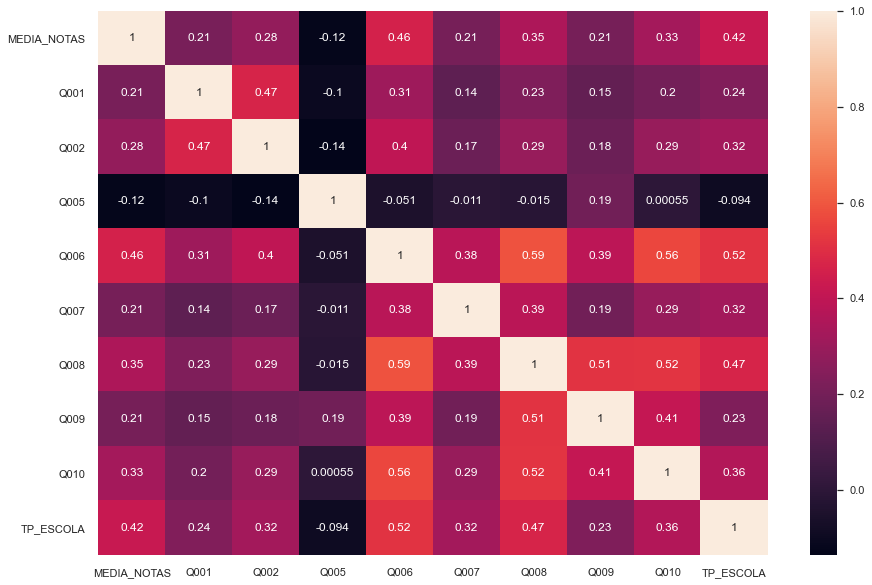

In [36]:
# Avaliação da correção entre variáveis
# (não foi encontrada nenhuma variável com correlão muito alta, para ser retirada do dataset)

corr = sample_kmeans.corr()
plt.figure(figsize = (15, 10))
sns.heatmap(
    corr, 
    xticklabels=corr.columns.values,
    yticklabels=corr.columns.values, 
    annot = True, 
    fmt='.2g'
)
plt.savefig('./ImgOut/heat_map.png')

In [37]:
# Removendo a coluna média das notas, para não interferir no resultado dos agrupamentos
media_notas = sample_kmeans['MEDIA_NOTAS']
del sample_kmeans['MEDIA_NOTAS']

<div align="justify">Para realizar a seleção do número <b>K-ótimo</b> de clusters, foram utilizadas as técnicas "Elbow" e "Silhouette", apresentadas a seguir:</div><br>

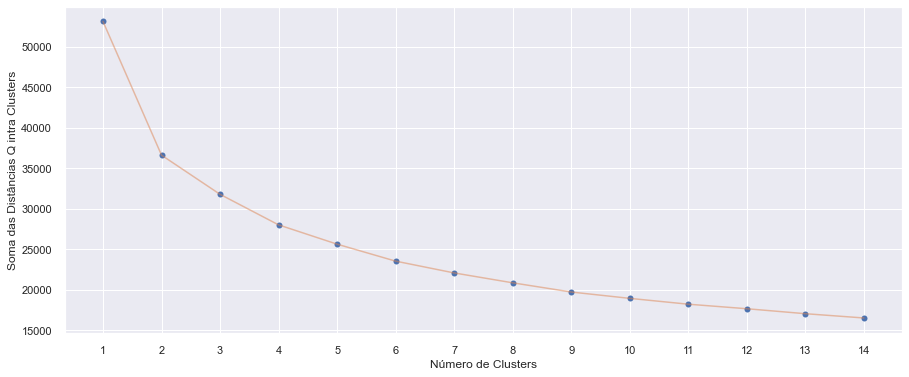

In [38]:
# Calcula a inertia, para saber o K ótimo

inertia = []
qtd_testes = 15
for n in range(1 , qtd_testes):
    algorithm = (
        KMeans(
            n_clusters = n
        )
    )
    algorithm.fit(sample_kmeans)
    inertia.append(algorithm.inertia_)

# Plotando valores da inertia
plt.figure(1 , figsize = (15 ,6))
plt.plot(np.arange(1 , qtd_testes) , inertia , 'o')
plt.plot(np.arange(1 , qtd_testes) , inertia , '-' , alpha = 0.5)
plt.xlabel('Número de Clusters') 
plt.xticks(ticks=np.arange(1 , qtd_testes))
plt.ylabel('Soma das Distâncias Q intra Clusters')
plt.savefig('./ImgOut/elbow.png')
plt.show()

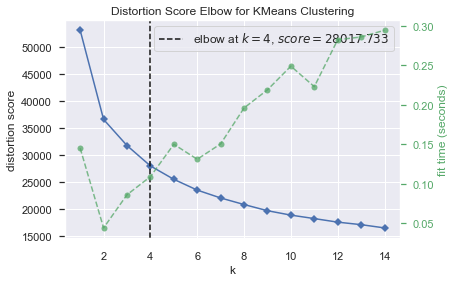

c:\users\aless\anaconda3\lib\site-packages\sklearn\base.py:209: FutureWarning:

From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.



KElbowVisualizer(ax=<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>,
                 k=None, model=None)

In [39]:
# Visualização do cotovelo pelo método Elbow, com a seleção do "k-ótimo"
kelbow_visualizer(
    KMeans(), 
    sample_kmeans, 
    k=(
        1,
        qtd_testes
    )
)

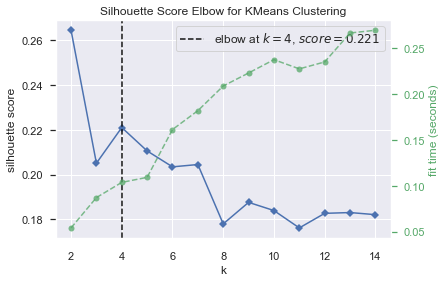

c:\users\aless\anaconda3\lib\site-packages\sklearn\base.py:209: FutureWarning:

From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.



KElbowVisualizer(ax=<AxesSubplot:title={'center':'Silhouette Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='silhouette score'>,
                 k=None, metric='silhouette', model=None)

In [40]:
# Visualização do cotovelo pelo método Silhouette, com a seleção do "k-ótimo"
kelbow_visualizer(
    KMeans(), 
    sample_kmeans, 
    k=(
        2,
        qtd_testes
    ), 
    metric='silhouette'
)

In [41]:
# Seleção automática do k-ótimo
kl = KneeLocator(
    range(
        1, 
        qtd_testes
    ), 
    inertia, 
    curve="convex", 
    direction="decreasing"
)

numero_de_clusters = kl.elbow
print('Número de clusters sugerido para o modelo: ', numero_de_clusters)

Número de clusters sugerido para o modelo:  4


In [42]:
# Inicializando e computando o KMeans :
algorithm = (
    KMeans(
        n_clusters=numero_de_clusters
    )
)
algorithm.fit(sample_kmeans)

KMeans(n_clusters=4)

In [43]:
# Reduzindo a dimensionalidade par uma melhor visualização
time_start = time.time()
tsne = TSNE()
visualizacao = tsne.fit_transform(sample_kmeans)
print('t-SNE executado! Tempo decorrido desde o início: ',format(time.time()-time_start), 'seconds')

t-SNE executado! Tempo decorrido desde o início:  13.144707918167114 seconds


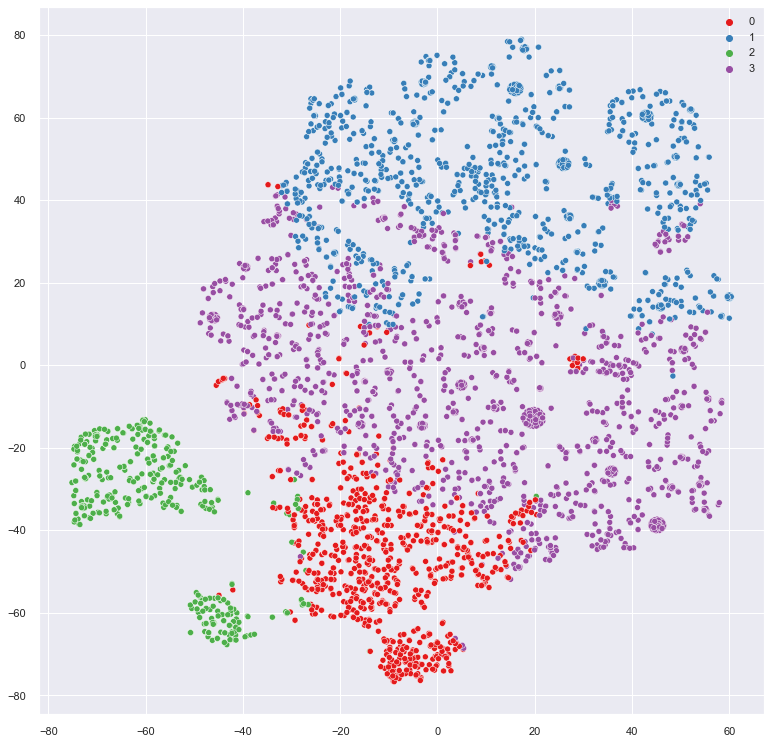

In [44]:
sns.set(
    rc={
        'figure.figsize': (13, 13)
    }
)

sns.scatterplot(
    x=visualizacao[:, 0],
    y=visualizacao[:, 1],
    hue=algorithm.labels_,
    palette=sns.color_palette(
        'Set1', 
        numero_de_clusters
    )
)
plt.savefig('./ImgOut/clustering.png')

In [45]:
sample_kmeans['Categoria'] = algorithm.labels_

In [46]:
# Scaler da média das notas
start = 0
end = 10
width = end - start
scaler_media = (media_notas - media_notas.min())/(media_notas.max() - media_notas.min()) * width + start
sample_kmeans['MEDIA_NOTAS'] = scaler_media

In [47]:
sample_kmeans.rename(
    columns = {
        'Q001':'Grau de instrução do pai', 
        'Q002':'Grau de instrução da mãe',         
        'Q005':'Número de pessoas na residência', 
        'Q006':'Grupo de renda mensal', 
        'Q007':'Possui empregada(o) doméstica(o) - dias',
        'Q008':'Qtd banheiro na residência', 
        'Q010':'Quantidade de carros na residência',                
        'Q009':'Quantidade de quartos na residência',
        'TP_ESCOLA': 'Tipo de escola',
        'MEDIA_NOTAS':  'Média da nota'
    }, 
    inplace = True
) 

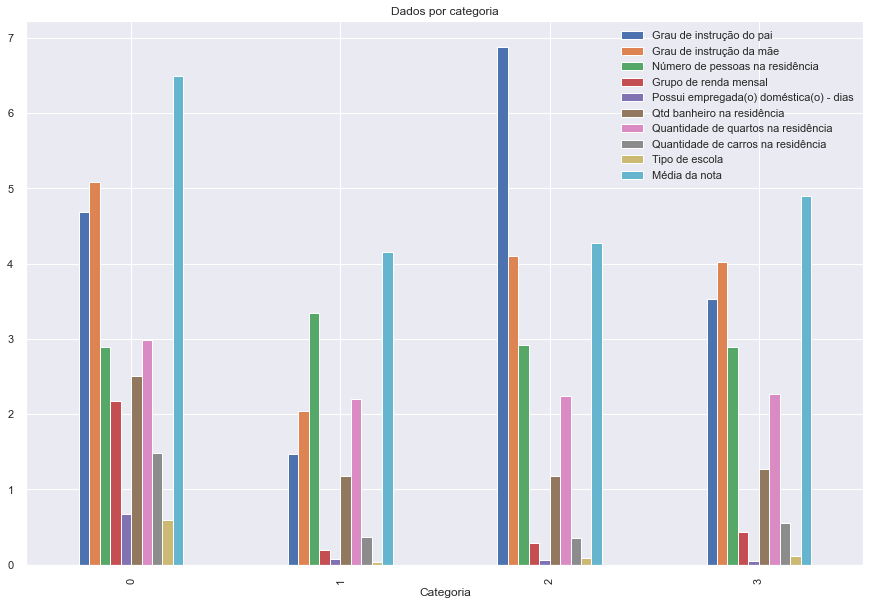

In [48]:
sample_kmeans.groupby("Categoria").aggregate("mean").plot.bar(figsize=(15,10))
plt.title("Dados por categoria")
plt.savefig('./ImgOut/agrupamento_final.png')

In [49]:
endd = time.time()
et = (endd - ini)/60
print('Elapsed Application time: {:.2f}'.format(et),' minutes')

Elapsed Application time: 10.91  minutes


# 3. RESULTADOS<br>


<div align="justify">De acordo com a análise dos agrupamentos sugeridos pelo K-Means, foram nomeados os quatro clusters como <b>A</b>, <b>B</b>, <b>C</b> e <b>D</b>. Essa classificação foi necessária para identificar, pelo gráfico anterior, a que grupo determinado participante do concurso do ENEM pode ser atribuído, visto que a cada execução da rotina, o identificador numérico dos grupos é aleatoriamente alterado.</div><br>

Grupo A:
-  Maior renda familiar;
-  Ambos os responsavéis tem um "ótimo" grau de instrução;
-  Melhores notas;
    
Grupo B:
-   Renda familiar média;
-   Ambos responsavéis tem um "bom" grau de instrução;
-   Boas notas;

Grupo C:
-   Renda familiar média;
-   Os responsavéis tem um bom grau de instrução;
-   Boas notas;
    
Grupo D:
-  Renda familiar baixa;
-  Ambos os responsavéis tem uma baixo grau de instrução;
-  Menores notas;

# 4. CONCLUSÃO<br>

<div align="justify">De acordo com as análises realizadas e com a cluesterização final, é verificado que um dos principais fatores que levam a um bom resultado do participante no ENEM é o grau de escolaridade dos responsáveis. Os indicadores socioeconômicos também aparecem como fatores que ajudam a impulsionar estes bons resultados. Isto é provado pelo cluster representado pelo grupo <b>A</b>, onde estão concentradas as melhores notas, e onde os responsáveis apresentam um elevado grau de instrução escolar e com um renda superior aos demais grupos.</div><br>

<div align="justify">Outro dado interessante de se avaliar está relacionado com o grupo <b>C</b>, no qual se percebe que, embora as notas não sejam as maiores, o grau de instrução do pai ou responsável masculino é bastante elevado, maior do que os do grupo <b>A</b>, por exemplo. Isso pode ser um indicativo de que há um efeito positivo no desempenho dos estudantes quando ambos os pais possuem grau de instrução equivalente. Ainda, pode estar relacionado com pais divorciados, padrastos ou com o fato de que a referência masculina pode ser um terceiro, como o avô, por exemplo, motivos a serem explorados em trabalhos futuros.</div><br>


# REFERÊNCIAS

<div align="justify"></div><br>


[1] MELLIT, Adel; KALOGIROU, Soteris A. Artificial intelligence techniques for photovoltaic applications: A review. Progress in energy and combustion science, v. 34, n. 5, p. 574-632, 2008.

[2] COSSETTI, Melissa. O que é inteligência artificial? Tecnoblog, 2020. Disponível em: https://tecnoblog.net/263808/o-que-e-inteligencia-artificial/. Acesso em: 17 dez. 2020.

[3] SAS - STATISTICAL ANALYSIS SYSTEM. Machine Learning: what it is and why it matters. What it is and why it matters. Disponível em: https://www.sas.com/en_us/insights/analytics/machine-learning.html. Acesso em: 30 nov. 2020.

[4] AMARAL, F. Aprenda Mineração de Dados: Teoria e prática. São Paulo: Alta Books, 2016.

[5] SHALEV-SHWARTZ, S.; BEN-DAVID, S. Understanding Machine Learning: From Theory to Algorithms. Cambridge: Cambridge University Press, 2014.

[6] BROWNLEE, Jason. Supervised and Unsupervised Machine Learning Algorithms. 2016. Disponível em: https://machinelearningmastery.com/supervised-and-unsupervised-machine-learning-algorithms/. Acesso em: 30 nov. 2020.

[7] MONARD, M. C.; BARANAUSKAS, J. A. Conceitos sobre Aprendizado de Máquina. In: REZENDE, S. O. Sistemas inteligentes: fundamentos e aplicações. [S.l.]: Editora Manole Ltda, 2003. Cap. 4, p. 39-56

[8] SANTANA, Felipe. Entenda o Algoritmo K-means e Saiba como Aplicar essa Técnica. 2017. Disponível em: https://minerandodados.com.br/entenda-o-algoritmo-k-means/. Acesso em: 03 dez. 2020.

[9] GUIDINI, Marilene Bertuol; NASCIMENTO, Auster Moreira; BONE, Rosemarie Bröker; ALVES, Tiago Wickstrom. APLICAÇÃO DO K-MEANS CLUSTER PARA A CLASSIFICAÇÃO DE ESTILOS GERENCIAIS. Rio de Janeiro: Enegep, 2018.

[10] FILHO, V. M. Um Novo Algoritmo de Agrupamento Semi-Supervisionado Baseado no Fuzzy C-Means. Universidade Federal de Pernambuco. Recife, p. 109. 2009.

[11] MINISTÉRIO DA EDUCAÇÃO. ENEM: apresentação. Apresentação. Disponível em: http://portal.mec.gov.br/enem-sp-2094708791. Acesso em: 01 dez. 2020.